#### **Install these in command prompt before execution**

In [1]:
!pip install pandas
!pip install numpy 
!pip install scikit-learn
!pip install matplotlib
!pip install seaborn 
!pip install missingno

#### **Load & Combine all Data**

In [3]:
import pandas as pd

# List of file paths for the 7 parts
file_paths = [f'dataset/uwb_dataset_part{i}.csv' for i in range(1, 8)]

# Load each part into a list of DataFrames
data_parts = [pd.read_csv(file_path, header=0) for file_path in file_paths]


# Combine all parts into a single DataFrame
combined_data = pd.concat(data_parts, ignore_index=True)

# Display the combined dataset
print(combined_data.head())
print(f"Combined dataset shape: {combined_data.shape}")

   NLOS  RANGE  FP_IDX  FP_AMP1  FP_AMP2  FP_AMP3  STDEV_NOISE  CIR_PWR  \
0   0.0   3.90   745.0  18712.0  10250.0  11576.0         64.0  11855.0   
1   0.0   0.66   749.0  11239.0   6313.0   4712.0         64.0  18968.0   
2   1.0   7.86   746.0   4355.0   5240.0   3478.0         60.0  14699.0   
3   1.0   3.48   750.0   8502.0   8416.0   5890.0         76.0   8748.0   
4   0.0   1.19   746.0  17845.0  18095.0  12058.0         68.0  11380.0   

   MAX_NOISE  RXPACC  ...  CIR1006  CIR1007  CIR1008  CIR1009  CIR1010  \
0      967.0   611.0  ...    279.0    458.0    183.0    158.0    198.0   
1     1133.0   447.0  ...    144.0    334.0    290.0    228.0    187.0   
2      894.0   723.0  ...     32.0    373.0    224.0    174.0    124.0   
3     1127.0  1024.0  ...    252.0    173.0    198.0    160.0    434.0   
4     1744.0   276.0  ...    154.0    209.0    242.0    296.0     87.0   

   CIR1011  CIR1012  CIR1013  CIR1014  CIR1015  
0     87.0    296.0    505.0    307.0      0.0  
1    2

In [4]:
# Check the number of rows in each part
for i, part in enumerate(data_parts, start=1):
    print(f"Part {i} shape: {part.shape}")

# Check the combined dataset
print(f"Combined dataset shape: {combined_data.shape}")
print(combined_data.head())

Part 1 shape: (6000, 1031)
Part 2 shape: (6000, 1031)
Part 3 shape: (6000, 1031)
Part 4 shape: (6000, 1031)
Part 5 shape: (6000, 1031)
Part 6 shape: (6000, 1031)
Part 7 shape: (6000, 1031)
Combined dataset shape: (42000, 1031)
   NLOS  RANGE  FP_IDX  FP_AMP1  FP_AMP2  FP_AMP3  STDEV_NOISE  CIR_PWR  \
0   0.0   3.90   745.0  18712.0  10250.0  11576.0         64.0  11855.0   
1   0.0   0.66   749.0  11239.0   6313.0   4712.0         64.0  18968.0   
2   1.0   7.86   746.0   4355.0   5240.0   3478.0         60.0  14699.0   
3   1.0   3.48   750.0   8502.0   8416.0   5890.0         76.0   8748.0   
4   0.0   1.19   746.0  17845.0  18095.0  12058.0         68.0  11380.0   

   MAX_NOISE  RXPACC  ...  CIR1006  CIR1007  CIR1008  CIR1009  CIR1010  \
0      967.0   611.0  ...    279.0    458.0    183.0    158.0    198.0   
1     1133.0   447.0  ...    144.0    334.0    290.0    228.0    187.0   
2      894.0   723.0  ...     32.0    373.0    224.0    174.0    124.0   
3     1127.0  1024.0  ... 

#### **Check for null value**

In [7]:
# Find columns with missing values
missing_values = combined_data.isnull().sum()
missing_cols = missing_values[missing_values > 0]
print("Columns with missing values:")
if not missing_cols.empty:
    print(missing_cols)
else:
    print("No missing values found.")

Columns with missing values:
No missing values found.


#### **Check for duplicate value**

In [8]:
# duplicate rows count
duplicate_rows = combined_data.duplicated().sum()
print(f"Number of duplicate rows: {duplicate_rows}")

# print duplicate rows if they exist
if duplicate_rows > 0:
    print("Sample duplicate rows:")
    print(combined_data[combined_data.duplicated()].head())

Number of duplicate rows: 0


#### **Combine FP Value**

In [10]:
import numpy as np
import pandas as pd

#based on the user manual. The A value for the First Path Power Level would be 121.74 since the PRF is 64MHz
A = 121.74

# Calculate First Path Power Level
combined_data['FP_POWER'] = 10 * np.log10(
    (combined_data['FP_AMP1']**2 + combined_data['FP_AMP2']**2 + combined_data['FP_AMP3']**2) / (combined_data['RXPACC']**2)
) - A

# Display the new column
print(combined_data[['FP_AMP1', 'FP_AMP2', 'FP_AMP3', 'RXPACC', 'FP_POWER']].head())

   FP_AMP1  FP_AMP2  FP_AMP3  RXPACC    FP_POWER
0  18712.0  10250.0  11576.0   611.0  -89.758158
1  11239.0   6313.0   4712.0   447.0  -91.995986
2   4355.0   5240.0   3478.0   723.0 -101.249715
3   8502.0   8416.0   5890.0  1024.0  -99.446556
4  17845.0  18095.0  12058.0   276.0  -81.574943


In [12]:
print(combined_data)

       NLOS  RANGE  FP_IDX  FP_AMP1  FP_AMP2  FP_AMP3  STDEV_NOISE  CIR_PWR  \
0       0.0   3.90   745.0  18712.0  10250.0  11576.0         64.0  11855.0   
1       0.0   0.66   749.0  11239.0   6313.0   4712.0         64.0  18968.0   
2       1.0   7.86   746.0   4355.0   5240.0   3478.0         60.0  14699.0   
3       1.0   3.48   750.0   8502.0   8416.0   5890.0         76.0   8748.0   
4       0.0   1.19   746.0  17845.0  18095.0  12058.0         68.0  11380.0   
...     ...    ...     ...      ...      ...      ...          ...      ...   
41995   0.0   2.43   745.0  12960.0  17703.0  14948.0         96.0   9987.0   
41996   0.0   1.39   745.0   2235.0  15089.0   8796.0         76.0  12559.0   
41997   1.0   5.48   747.0   7115.0   6262.0   4584.0         72.0   1435.0   
41998   1.0   3.40   745.0   6662.0   7683.0   5600.0         72.0   1491.0   
41999   0.0   2.43   747.0   2621.0  10276.0   6284.0         56.0   9116.0   

       MAX_NOISE  RXPACC  ...  CIR1007  CIR1008  CI

#### **Calculate RX Level**

In [29]:
# Assuming combined_data is your DataFrame and it contains the necessary columns
# CIR_PWR: Channel Impulse Response Power
# RXPACC: Preamble Accumulation Count
# PRF: Pulse Repetition Frequency (16 MHz or 64 MHz)

# Define the A value based on PRF
# For PRF of 64 MHz
A = 121.74

# Filter out rows where RXPACC is zero

# Calculate RX Level
combined_data['RX_LEVEL'] = 10 * np.log10(
    (combined_data['CIR_PWR'] * 2**17) / (combined_data['RXPACC']**2)
) - A

# Display the new column
print(combined_data[['CIR_PWR', 'RXPACC', 'RX_LEVEL']].head())

   CIR_PWR  RXPACC   RX_LEVEL
0  11855.0   611.0 -85.546709
1  18968.0   447.0 -80.790836
2  14699.0   723.0 -86.074789
3   8748.0  1024.0 -91.351812
4  11380.0   276.0 -78.821660


C:\Users\Leong Jing Feng\anaconda3\envs\DA_Project\Lib\site-packages\pandas\core\arraylike.py:399: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


#### **Check whether if CIR_value is linear or non-linear**

In [30]:
# Check columns that start with 'CIR'
cir_columns = combined_data.filter(regex='^CIR')
print(f"Number of CIR columns: {cir_columns.shape[1]}")
print(f"CIR columns: {cir_columns.columns.tolist()}")

Number of CIR columns: 1017
CIR columns: ['CIR_PWR', 'CIR0', 'CIR1', 'CIR2', 'CIR3', 'CIR4', 'CIR5', 'CIR6', 'CIR7', 'CIR8', 'CIR9', 'CIR10', 'CIR11', 'CIR12', 'CIR13', 'CIR14', 'CIR15', 'CIR16', 'CIR17', 'CIR18', 'CIR19', 'CIR20', 'CIR21', 'CIR22', 'CIR23', 'CIR24', 'CIR25', 'CIR26', 'CIR27', 'CIR28', 'CIR29', 'CIR30', 'CIR31', 'CIR32', 'CIR33', 'CIR34', 'CIR35', 'CIR36', 'CIR37', 'CIR38', 'CIR39', 'CIR40', 'CIR41', 'CIR42', 'CIR43', 'CIR44', 'CIR45', 'CIR46', 'CIR47', 'CIR48', 'CIR49', 'CIR50', 'CIR51', 'CIR52', 'CIR53', 'CIR54', 'CIR55', 'CIR56', 'CIR57', 'CIR58', 'CIR59', 'CIR60', 'CIR61', 'CIR62', 'CIR63', 'CIR64', 'CIR65', 'CIR66', 'CIR67', 'CIR68', 'CIR69', 'CIR70', 'CIR71', 'CIR72', 'CIR73', 'CIR74', 'CIR75', 'CIR76', 'CIR77', 'CIR78', 'CIR79', 'CIR80', 'CIR81', 'CIR82', 'CIR83', 'CIR84', 'CIR85', 'CIR86', 'CIR87', 'CIR88', 'CIR89', 'CIR90', 'CIR91', 'CIR92', 'CIR93', 'CIR94', 'CIR95', 'CIR96', 'CIR97', 'CIR98', 'CIR99', 'CIR100', 'CIR101', 'CIR102', 'CIR103', 'CIR104', 'CIR105

In [31]:
# Extract columns CIR0 to CIR1015 (adjusted range)
pca_data = combined_data.loc[:, 'CIR0':'CIR1015'].copy()  # Select columns CIR0 to CIR1015
target = combined_data['NLOS']  # Target variable (NLOS)

In [32]:
# Step 2: Check linear correlation between features and target
correlation_with_target = pca_data.corrwith(target)
print("Correlation with target (NLOS):")
print(correlation_with_target)

Correlation with target (NLOS):
CIR0       0.204386
CIR1       0.181933
CIR2       0.133125
CIR3       0.177418
CIR4       0.099459
             ...   
CIR1011    0.183408
CIR1012    0.095495
CIR1013    0.182948
CIR1014    0.229277
CIR1015    0.092241
Length: 1016, dtype: float64


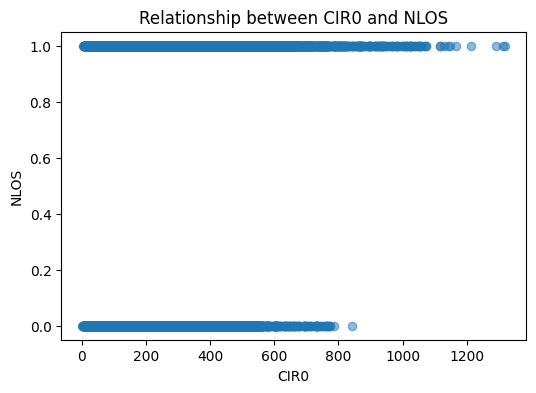

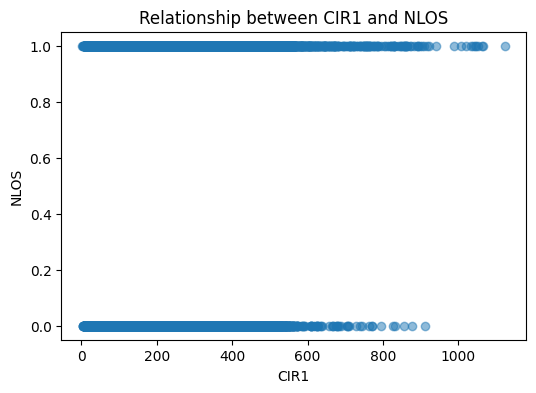

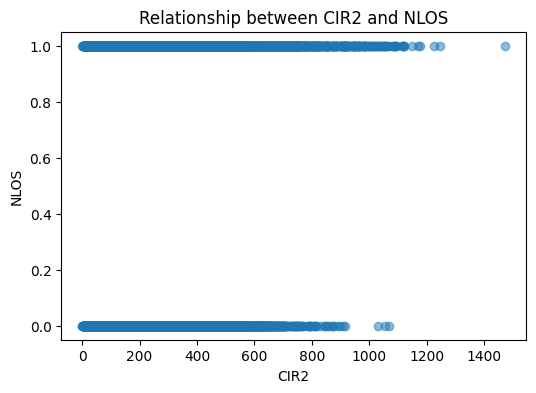

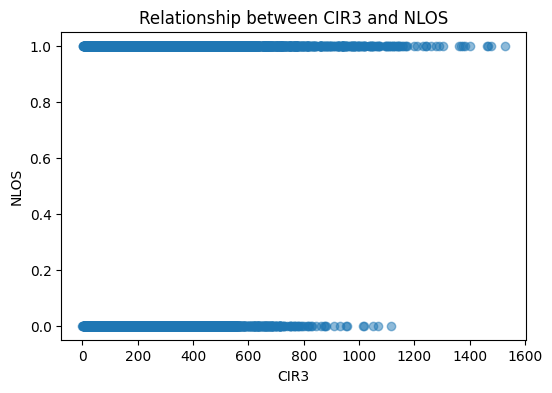

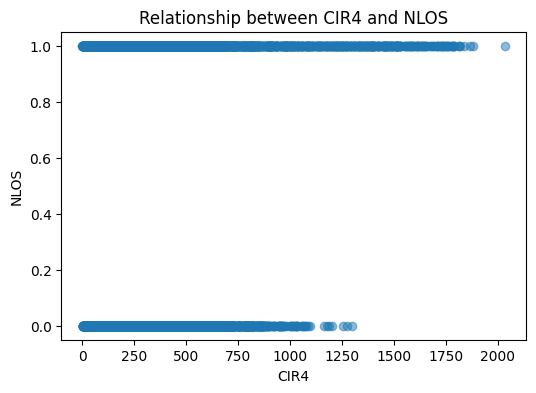

...

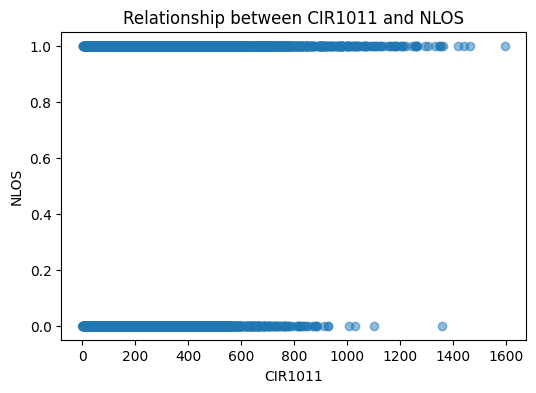

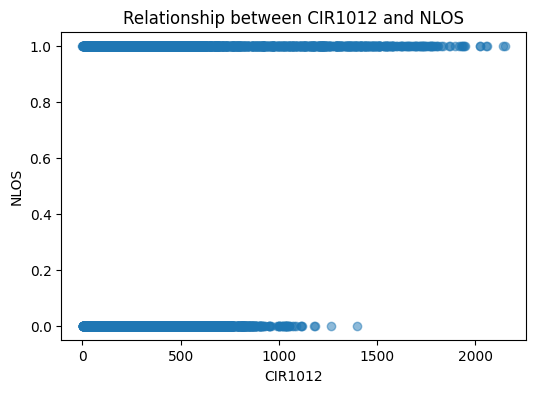

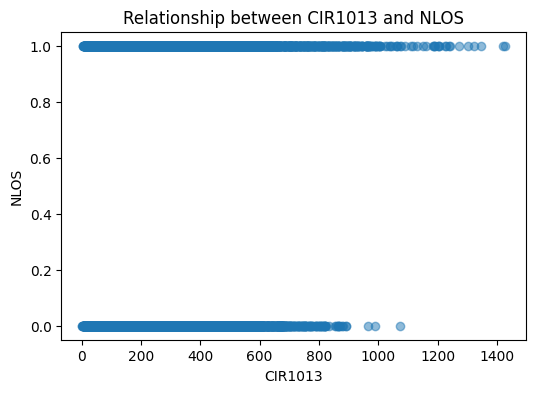

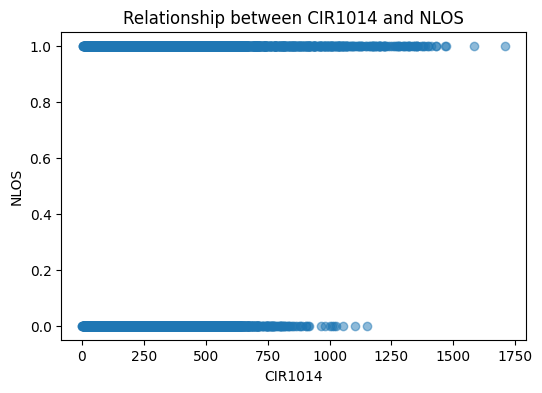

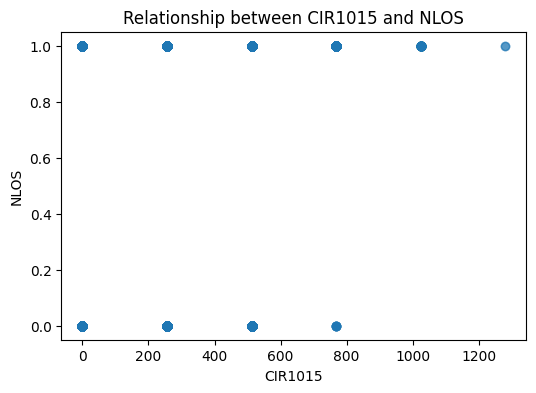

In [25]:
import matplotlib.pyplot as plt

# Step 3: Visualize the relationship between each feature and the target (scatter plots)
for feature in pca_data.columns:
    plt.figure(figsize=(6, 4))
    plt.scatter(pca_data[feature], target, alpha=0.5)
    plt.xlabel(feature)
    plt.ylabel('NLOS')
    plt.title(f'Relationship between {feature} and NLOS')
    plt.show()

#### **Do PCA on CIR_value if linear [Li En's Code]**

In [34]:
# Step 4: If correlation looks strong and linear, we can proceed with PCA
# Compute the mean (𝛍) for each feature and center the data
mean_vals = pca_data.mean(axis=0)
centered_data = pca_data - mean_vals

In [35]:
# Step 5: Calculate the covariance matrix
cov_matrix = np.cov(centered_data, rowvar=False)

In [36]:
# Step 6: Find eigenvalues and eigenvectors
eigenvalues, eigenvectors = np.linalg.eigh(cov_matrix)

In [37]:
# Step 7: Sort eigenvectors based on eigenvalues (descending order)
sorted_indices = np.argsort(eigenvalues)[::-1]
eigenvalues = eigenvalues[sorted_indices]
eigenvectors = eigenvectors[:, sorted_indices]

In [38]:
# Step 8: Compute explained variance ratio
explained_variance_ratio = eigenvalues / np.sum(eigenvalues)

# Step 9: Compute cumulative explained variance
cumulative_variance = np.cumsum(explained_variance_ratio)

# Step 10: Choose the number of components (k) to retain 95% variance
k = np.argmax(cumulative_variance >= 0.95) + 1
top_k_eigenvectors = eigenvectors[:, :k]

In [39]:
# Step 11: Project the data onto the selected principal components
pca_transformed_data = np.dot(centered_data, top_k_eigenvectors)

# Step 12: Assign feature names to the principal components
original_feature_names = list(pca_data.columns)
pca_feature_names = [
    original_feature_names[np.argmax(np.abs(top_k_eigenvectors[:, i]))]
    for i in range(k)
]

In [40]:
# Step 13: Convert transformed data into a DataFrame with principal component labels
pca_df = pd.DataFrame(pca_transformed_data, columns=pca_feature_names)

# Step 14: Display results
print(f"Original Data Shape: {pca_data.shape}")
print("Remaining Features After PCA:")
for col in pca_df.columns:
    print(col)
print(f"Reduced Data Shape: {pca_df.shape}")
print(f"Explained Variance by {k} PCs: {cumulative_variance[k-1]:.4f}")

Original Data Shape: (42000, 1016)
Remaining Features After PCA:
CIR746
CIR748
CIR750
CIR752
CIR750
CIR752
CIR753
CIR754
CIR754
CIR755
CIR756
CIR757
CIR756
CIR757
CIR759
CIR760
CIR761
CIR762
CIR761
CIR762
CIR762
CIR763
CIR764
CIR765
CIR765
CIR746
CIR770
CIR769
CIR770
CIR771
CIR772
CIR745
CIR776
CIR775
CIR779
CIR780
CIR781
CIR776
CIR783
Reduced Data Shape: (42000, 39)
Explained Variance by 39 PCs: 0.9510


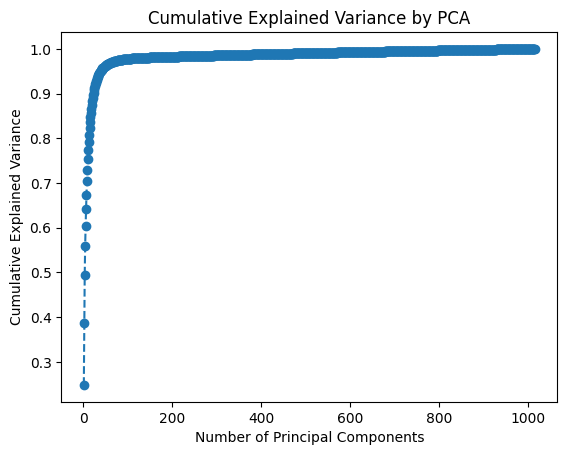

In [41]:
# Step 15: Visualize the cumulative explained variance
plt.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, marker='o', linestyle='--')
plt.title('Cumulative Explained Variance by PCA')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.show()

In [42]:
print(pca_df)

             CIR746        CIR748        CIR750       CIR752       CIR750  \
0      10542.237793 -10442.542305  -2905.567297  1828.041867  6209.317048   
1     -27872.624304  -1550.982824  -8485.147606 -8705.706506  6799.997937   
2     -16005.857827   -534.227970 -11330.934957  1447.770837  4459.055211   
3     -12676.250223   8813.187046  -5317.176338 -2178.557864  4905.781088   
4      12304.979262 -10566.694309   8213.167710  3534.056718  3367.453692   
...             ...           ...           ...          ...          ...   
41995   9251.728815  -4406.326762 -10371.315700  1369.505389  5629.968535   
41996   4659.334882 -11906.859265   4479.577221  -383.493282 -8792.979433   
41997   7343.051066  13008.625585   4665.062113  5583.933337  1722.324855   
41998  13592.440266  14388.089489   -446.771533 -1376.732785   311.579842   
41999  -4157.308953  -2084.092677  14858.734699 -1749.891536 -2790.475830   

            CIR752       CIR753       CIR754       CIR754       CIR755  ...

#### **Combined with my other features** 

In [44]:
# Select all columns that are not in the CIR0 to CIR1015 range
other_features = combined_data.drop(columns=pca_data.columns).copy()

In [45]:
combined_data_with_pca = pd.concat([pca_df, other_features], axis=1)

In [48]:
# To display all column names
print(combined_data_with_pca.columns.tolist())

['CIR746', 'CIR748', 'CIR750', 'CIR752', 'CIR750', 'CIR752', 'CIR753', 'CIR754', 'CIR754', 'CIR755', 'CIR756', 'CIR757', 'CIR756', 'CIR757', 'CIR759', 'CIR760', 'CIR761', 'CIR762', 'CIR761', 'CIR762', 'CIR762', 'CIR763', 'CIR764', 'CIR765', 'CIR765', 'CIR746', 'CIR770', 'CIR769', 'CIR770', 'CIR771', 'CIR772', 'CIR745', 'CIR776', 'CIR775', 'CIR779', 'CIR780', 'CIR781', 'CIR776', 'CIR783', 'NLOS', 'RANGE', 'FP_IDX', 'FP_AMP1', 'FP_AMP2', 'FP_AMP3', 'STDEV_NOISE', 'CIR_PWR', 'MAX_NOISE', 'RXPACC', 'CH', 'FRAME_LEN', 'PREAM_LEN', 'BITRATE', 'PRFR', 'FP_POWER', 'RX_LEVEL']


#### **Check any column with 0 variance (trivial feature)** 